In [1]:
import matplotlib.pyplot as plt 
import matplotlib.image as img
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle
from matplotlib.patches import ConnectionPatch
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import numpy as np
import richardsplot
import os

/Users/trevormccaffrey/anaconda3/lib/python3.6/_collections_abc.py:841: MatplotlibDeprecationWarning: Support for setting the 'text.latex.preamble' or 'pgf.preamble' rcParam to a list of strings is deprecated since 3.3 and will be removed two minor releases later; set it to a single string instead.
  self[key] = other[key]


In [26]:
#Values stored manually in 
#"/Users/trevormccaffrey/Desktop/Research/RQQSOs_AmyKimball/contour_props.txt"

#Store image props in dictionary - easy then to call in plotting
#Index 0 of tuple is linear size in kpc;
#Index 1 of tuple is the value of the base contour in µJy
#Index 2 of tuple tells where to put the inset box in the A-config image
imsize   = 0
scale    = 1
insetbox = 2
insetimg = 3
morph    = 4



imgs = {
    
    "0822+4553": (30.3, 24.7, (180, 480, 485, 185), [0.6, 0.03, 0.37, 0.37], 'M'),
    "0843+5357": (12.7, 24.7, (257, 417, 419, 259), [0.6, 0.6, 0.37, 0.37], 'E'),
    "0858+3423": (20.7, 24.7, (253.5, 423.5, 405, 235), [0.6, 0.03, 0.37, 0.37], 'M'),
    "0935+4819": (14.4, 35.4, (260, 430, 417, 247), [0.6, 0.03, 0.37, 0.37], 'D'),
    "0944+3608": (20.4, 24.7, (248, 468, 470, 250), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1004+1510": (17.0, 24.7, (275, 415, 415, 275), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1013+2212": (28.4, 24.7, (200, 455, 460, 205), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1021+1900": (17.4, 21.6, (285, 461, 425, 245), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1041+2828": (23.7, 24.7, (185, 485, 480, 180), [0.6, 0.03, 0.37, 0.37], 'M'),
    "1045+2933": (26.7, 21.6, (200, 455, 430, 185), [0.6, 0.03, 0.37, 0.37], 'M'),
    "1045+5202": (30.0, 24.7, (195, 495, 480, 180), [0.03, 0.6, 0.37, 0.37], 'M'),
    "1118+3103": (15.7, 23.3, (257, 433, 418, 242), [0.6, 0.03, 0.37, 0.37], 'M'),
    "1146+3715": (21.1, 24.7, (250, 455, 450, 255), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1155+5021": (23.6, 28.3, (235, 450, 460, 245), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1157-0022": (15.3, 24.7, (260, 415, 415, 260), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1233+6443": (21.5, 28.3, (230, 455, 465, 240), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1235+4104": (17.9, 24.7, (245, 415, 430, 260), [0.6, 0.6, 0.37, 0.37], 'E'),
    "1304+0205": (15.4, 24.7, (265, 425, 435, 275), [0.6, 0.6, 0.37, 0.37], 'E'),
    "1408+4303": (14.8, 17.7, (265, 420, 425, 275), [0.6, 0.6, 0.37, 0.37], 'E'),
    "1421+0739": (14.4, 24.7, (235, 425, 455, 265), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1429+4747": (17.8, 28.3, (235, 455, 455, 235), [0.6, 0.6, 0.37, 0.37], 'M'),
    "1444+0633": (19.0, 24.7, (235, 450, 465, 250), [0.6, 0.6, 0.37, 0.37], 'E'),
    "1529+0216": (17.4, 24.7, (279, 434, 410, 260), [0.6, 0.03, 0.37, 0.37], 'E'),
    "1727+6322": (21.4, 24.7, (255, 442, 422, 242), [0.6, 0.03, 0.37, 0.37], 'E')
    
}

In [27]:
imgs_SR = {
    
    "0816+4258": (9.3, 17.5),
    "0847+2631": (10.7, 17.5),
    "0856+1057": (10.4, 17.5),
    "0930+2044": (9.6, 17.5),
    "0948+4335": (9.1, 17.5),
    "1010+3003": (9.9, 17.5),
    "1036+2750": (10.7, 15.),
    "1054+3511": (5.4, 16.),
    "1129+0629": (9.5, 15.),
    "1129+5120": (11.2, 20.),
    "1155+5931": (10.7, 17.5),
    "1157-0315": (8.7, 17.5),
    "1204+1702": (9.8, 17.5),
    "1209+0232": (9.4, 17.5),
    "1210+2725": (5.9, 17.5),
    "1212+1859": (8.4, 15.),
    "1221+2604": (10.6, 17.5),
    "1245+0321": (7.6, 16.5),
    "1248+3424": (10.4, 17.),
    "1307+0107": (9.2, 17.),
    "1308+0344": (9.1, 17.5),
    "1312+0641": (4.6, 17.5),
    "1320+2957": (5.4, 17.5),
    "1322+3623": (7.5, 17.5),
    "1348+4303": (9.2, 17.5),
    "1421+1520": (6.3, 17.5),
    "1425+0803": (7.7, 17.5),
    "1458+3631": (7.9, 17.5),
    "1527+1541": (7.7, 17.5),
    "1617+0854": (8.1, 16.5),
    "1619+2543": (9.9, 17.)
    
}

In [28]:
len(imgs)

24

/Users/trevormccaffrey/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:54: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


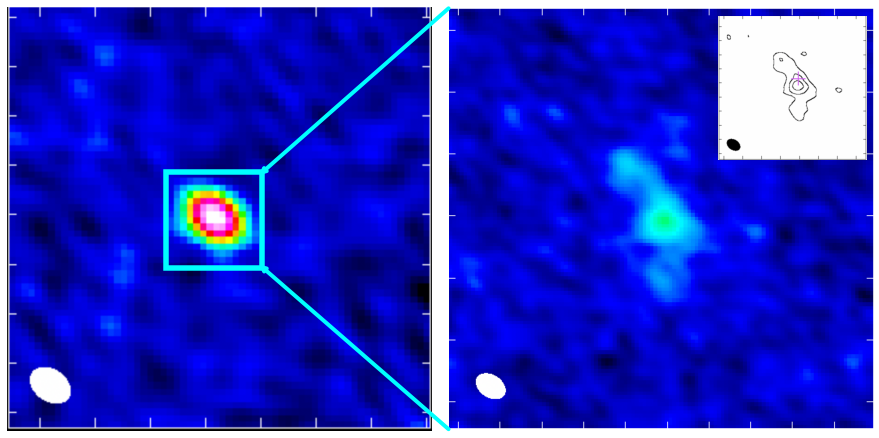

In [29]:
#Create path to images we will use
pathA    = r'PaperPlots/contour_maps/1727+6322/1727+6322_A.png'
pathC    = 'PaperPlots/contour_maps/1727+6322/1727+6322_colorC.png'
pathCont = 'PaperPlots/contour_maps/1727+6322/1727+6322_contourmap.png'

fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(12.5,8))

#Show the C-config image
imC = img.imread(pathC)
ax1.imshow(imC)

#Define the zoom region (the unresolved source)
boxcol  = "cyan"
zoomblcx= 0.375
zoomblcy= 0.385
dimbox  = 0.225
zoombox = Rectangle((zoomblcx, zoomblcy), dimbox, dimbox, facecolor="none", edgecolor=boxcol, linewidth=5.5, 
                    transform=ax1.transAxes)
ax1.add_patch(zoombox)

#ax.annotate('', xy=(155, 650), xytext=(228, 0), textcoords='offset points', 
 #       arrowprops=dict(arrowstyle="<|-|>, head_width=0.3, head_length=0.6"))
#ax.annotate('15 kpc', xy=(325, 635), xytext=(0, 0), textcoords='offset points') 

# Draw an arrow between the same point in data coordinates,
# but in different axes.
con1 = ConnectionPatch(
    xyA=(0.0,1.0), coordsA=ax2.transAxes,
    xyB=(zoomblcx+dimbox-.015, zoomblcy+dimbox-.015), coordsB=ax1.transAxes,
    arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
fig.add_artist(con1)

con2 = ConnectionPatch(
    xyA=(0.0,0.0), coordsA=ax2.transAxes,
    xyB=(zoomblcx+dimbox-.015, zoomblcy+.015), coordsB=ax1.transAxes,
    arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
fig.add_artist(con2)


imA = img.imread(pathA)
ax2.imshow(imA)

axins = inset_axes(ax2,
                    width="35%", # width = 30% of parent_bbox
                    height="35%", # height : 1 inch
                    loc=1)
imCont = img.imread(pathCont)
axins.imshow(imCont)
axins.axis("off")

ax1.axis("off")
ax2.axis("off")
plt.subplots_adjust(wspace=0.015)
plt.tight_layout()
plt.show()
                

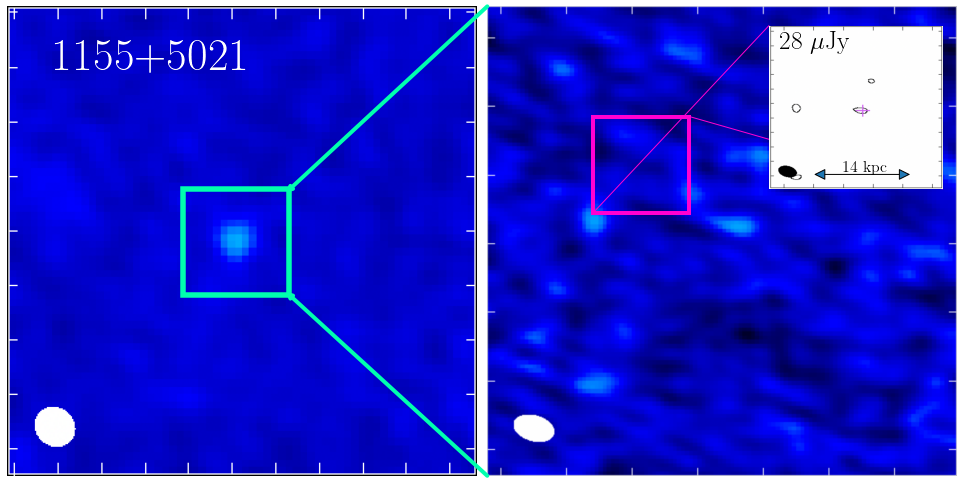

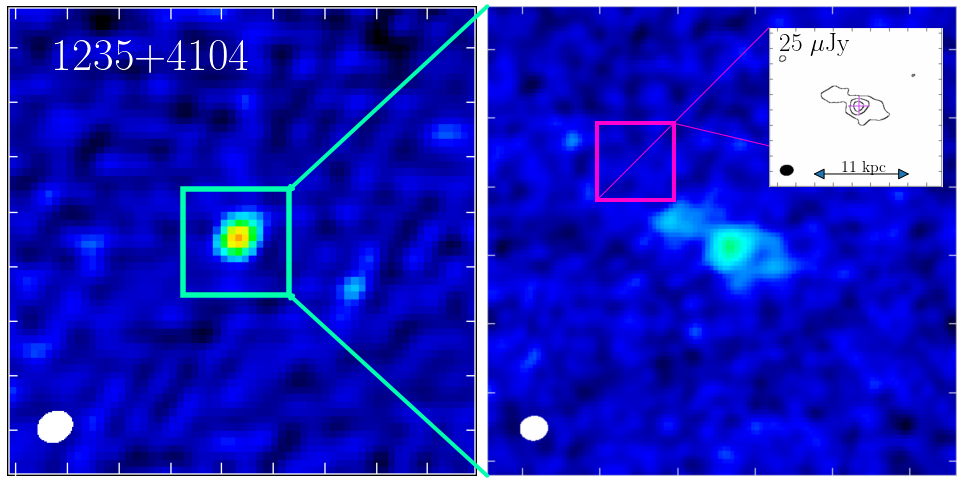

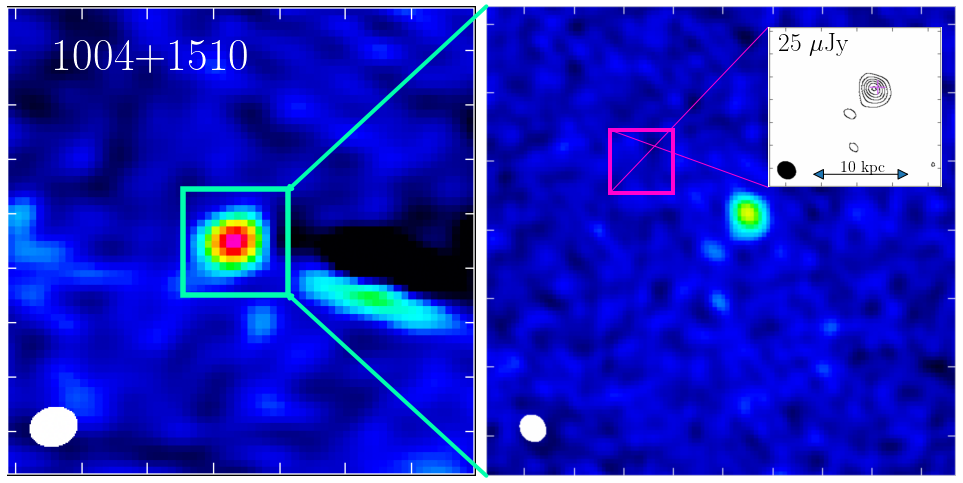

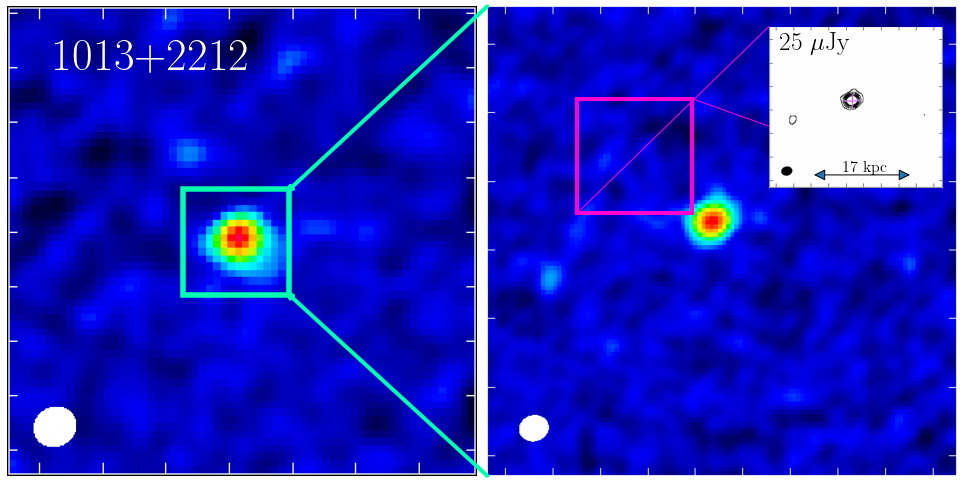

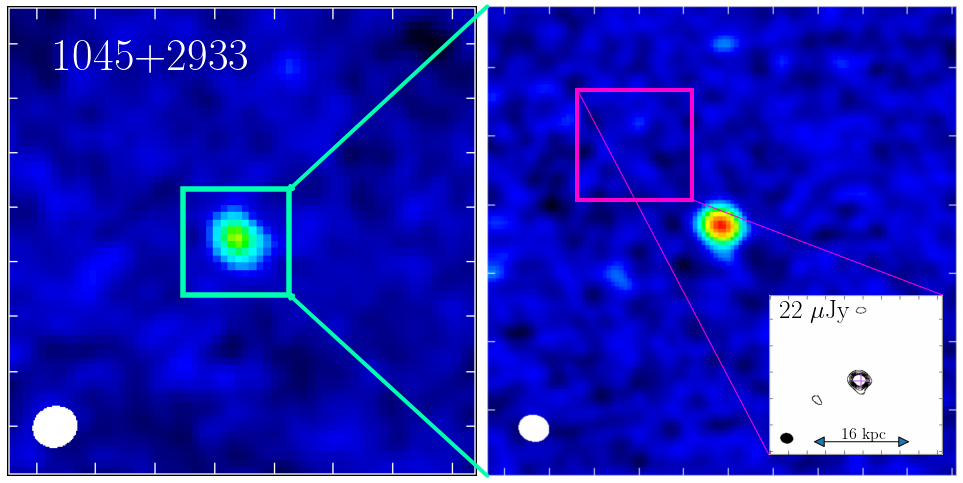

...

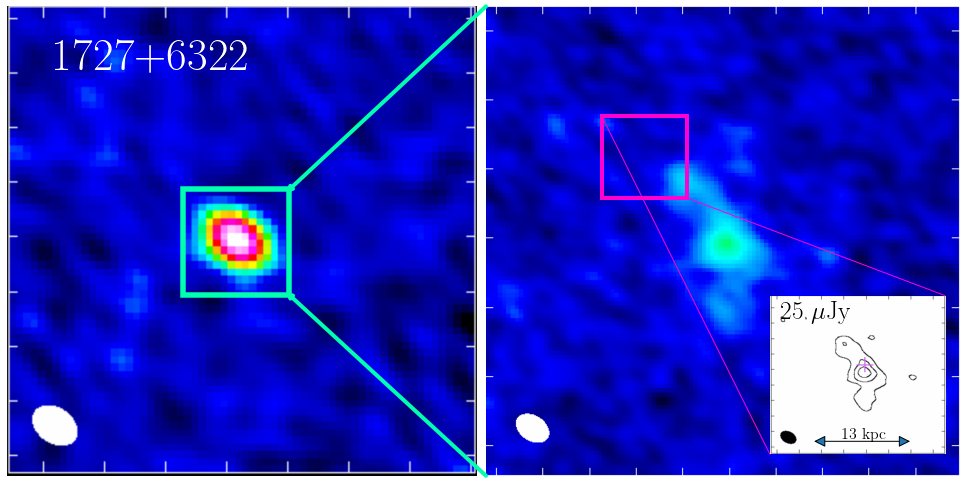

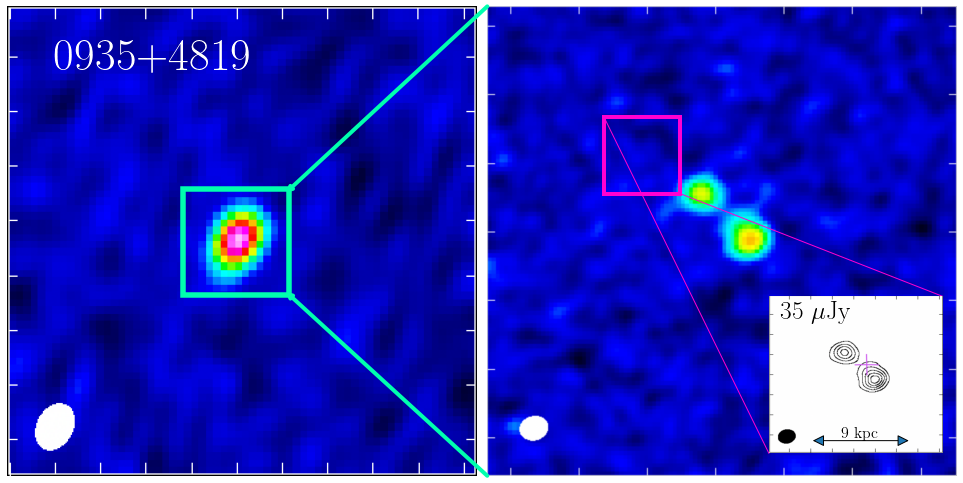

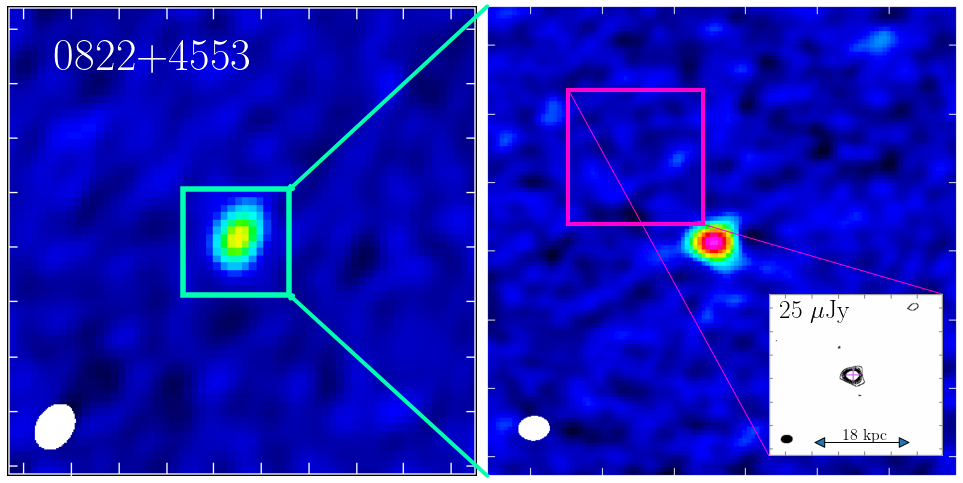

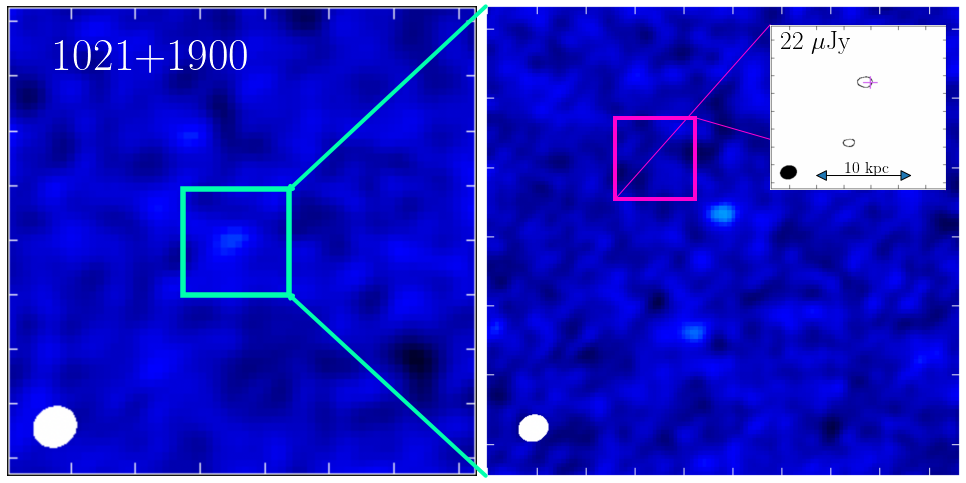

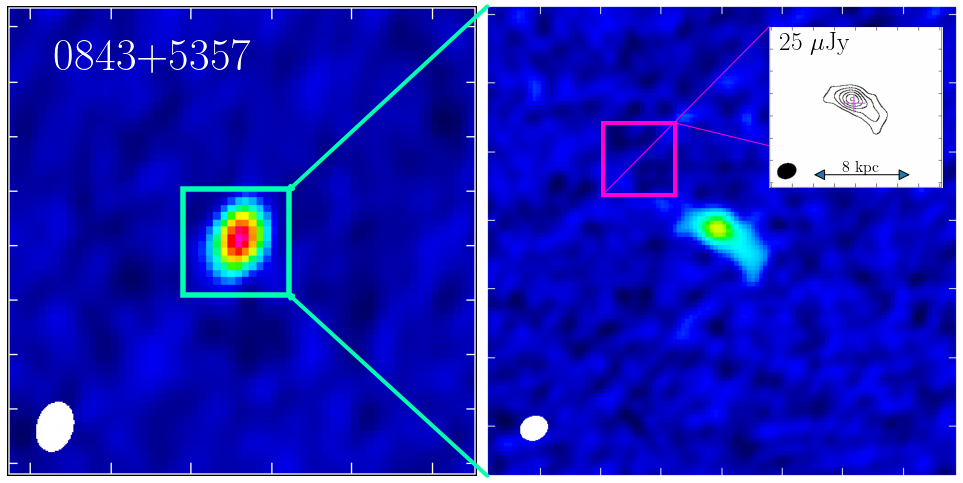

In [30]:
path = "PaperPlots/contour_maps/"

for obj in os.listdir(path):
    if not obj.startswith("."): #ignore hidden files/directories
        fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(15,7))
        
        #Show the C-config image
        imC = img.imread(path+obj+"/{}_colorC.png".format(obj))
        ax1.imshow(imC)
        
        #Define the zoom region (the unresolved source)
        boxcol  = "#00FFAE"
        zoomblcx= 0.375
        zoomblcy= 0.385
        dimbox  = 0.225
        zoombox = Rectangle((zoomblcx, zoomblcy), dimbox, dimbox, facecolor="none", edgecolor=boxcol, linewidth=5.5, 
                            transform=ax1.transAxes)
        ax1.add_patch(zoombox)
        ax1.annotate(obj, xy=(70, 95), xytext=(0, 0), textcoords='offset points', color="w", fontsize=45) 

      
            
        # Draw an arrow between the same point in data coordinates,
        # but on different axes.
        con1 = ConnectionPatch(
            xyA=(0.0,1.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+dimbox-.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con1)

        con2 = ConnectionPatch(
            xyA=(0.0,0.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con2)
                
        imA = img.imread(path+obj+"/{}_A.png".format(obj))
        ax2.imshow(imA)
        
        
        # inset axes....
        axins = ax2.inset_axes(imgs[obj][insetimg])
        imCont = img.imread(path+obj+"/{}_contourmap.png".format(obj))
        axins.imshow(imCont)
        axins_xlims = axins.get_xlim()
        axins_ylims = axins.get_ylim()
        # sub region of the original image
        (x1, x2, y1, y2) = imgs[obj][insetbox]
        axins.set_xlim(x1, x2)
        axins.set_ylim(y1, y2)
        axins.set_xticklabels('')
        axins.set_yticklabels('')

        ax2.indicate_inset_zoom(axins, edgecolor="#ff00d1", lw=4.0, alpha=1.0)
        #Reset contour limits to original
        axins.set_xlim(axins_xlims)
        axins.set_ylim(axins_ylims)

        #axins = inset_axes(ax2,
         #                   width="40%", # width = 30% of parent_bbox
          #                  height="40%", # height : 1 inch
           #                 loc=1)
        
        
        axins.annotate('', xy=(175, 650), xytext=(100, 0), textcoords='offset points', 
                        arrowprops=dict(arrowstyle="<|-|>, head_width=0.3, head_length=0.6"))
        axins.annotate(str(round(0.6*imgs[obj][imsize]))+" kpc", xy=(300, 635), xytext=(0, 0), textcoords='offset points') 
        axins.annotate(str(round(imgs[obj][scale]))+" $\mu$Jy", xy=(45, 100), fontsize=25.5,
                                  xytext=(0, 0), textcoords='offset points')
        
        axins.axis("off")
        ax1.axis("off")
        ax2.axis("off")
        plt.subplots_adjust(left=0.075, right=0.9, bottom=0.2, top=0.8)
        plt.tight_layout()
        #plt.savefig("PaperPlots/images_insets/{}_insets.pdf".format(obj), bbox_inches = 'tight', pad_inches = 0)
        plt.show()

Let's move the inset contours to their own separate subplot in each figure -- that way we can zoom in to the A-config color-scaled images much more.

In [31]:
for i in imgs: print(i)

0822+4553
0843+5357
0858+3423
0935+4819
0944+3608
1004+1510
1013+2212
1021+1900
1041+2828
1045+2933
1045+5202
1118+3103
1146+3715
1155+5021
1157-0022
1233+6443
1235+4104
1304+0205
1408+4303
1421+0739
1429+4747
1444+0633
1529+0216
1727+6322


In [32]:
imgs["1727+6322"]

(21.4, 24.7, (255, 442, 422, 242), [0.6, 0.03, 0.37, 0.37], 'E')

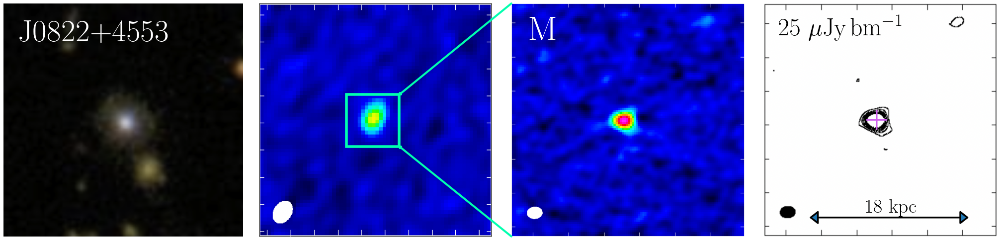

In [33]:
path = "PaperPlots/contour_maps/"

i = 0
for obj in imgs:
    if i > 0: break
    i+=1
    if not obj.startswith("."): #ignore hidden files/directories
        fig, [ax0, ax1, ax2, ax3] = plt.subplots(1, 4, figsize=(30,7))
        
        #Show the SDSS u?-image
        imSDSS = img.imread(path+obj+"/{}_SDSS.png".format(obj))
        ax0.imshow(imSDSS)
        ax0.annotate("J"+obj, xy=(25, 60), xytext=(0, 0), textcoords='offset points', 
                     color="w", fontsize=62.5)
        
        #Show the C-config image
        imC = img.imread(path+obj+"/{}_colorC.png".format(obj))
        ax1.imshow(imC)
        
        #Define the zoom region (the unresolved source)
        boxcol  = "#00FFAE"
        zoomblcx= 0.375
        zoomblcy= 0.385
        dimbox  = 0.225
        zoombox = Rectangle((zoomblcx, zoomblcy), dimbox, dimbox, facecolor="none", edgecolor=boxcol, linewidth=5.5, 
                            transform=ax1.transAxes)
        ax1.add_patch(zoombox) 
            
        # Draw an arrow between the same point in data coordinates,
        # but on different axes.
        con1 = ConnectionPatch(
            xyA=(0.0,1.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+dimbox-.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con1)

        con2 = ConnectionPatch(
            xyA=(0.0,0.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con2)
                
        imA = img.imread(path+obj+"/{}_A.png".format(obj))
        ax2.imshow(imA)
        ax2.annotate(imgs[obj][morph], xy=(80, 165), fontsize=70, color="w",
                                  xytext=(0, 0), textcoords='offset points')
        
        #Show the Contour map
        imCont = img.imread(path+obj+"/{}_contourmap.png".format(obj))
        ax3.imshow(imCont)
        
        ax3.annotate('', xy=(135, 650), xytext=(325, 0), textcoords='offset points', 
                        arrowprops=dict(arrowstyle="<|-|>, head_width=0.7, head_length=0.9",
                                       linewidth=3.5))
        ax3.annotate(str(round(0.6*imgs[obj][imsize]))+" kpc", xy=(310, 635), xytext=(0, 0), 
                     textcoords='offset points', fontsize=40) 
        
        if obj=="1045+2933":
            ax3.annotate(str(round(imgs[obj][scale]))+" $\mu$Jy\,bm$^{-1}$", xy=(45, 180), fontsize=50,
                                  xytext=(0, 0), textcoords='offset points')
        else:
            ax3.annotate(str(round(imgs[obj][scale]))+" $\mu$Jy\,bm$^{-1}$", xy=(45, 100), fontsize=50,
                                  xytext=(0, 0), textcoords='offset points')
        
        ax0.axis("off")
        ax1.axis("off")
        ax2.axis("off")
        ax3.axis("off")
        plt.subplots_adjust(left=0.05, right=0.9, bottom=0.2, top=0.8)
        plt.tight_layout()
        #plt.savefig("PaperPlots/images_insets/{}_{}_insets.pdf".format(imgs[obj][morph], obj), bbox_inches = 'tight', pad_inches = 0)
        plt.show()

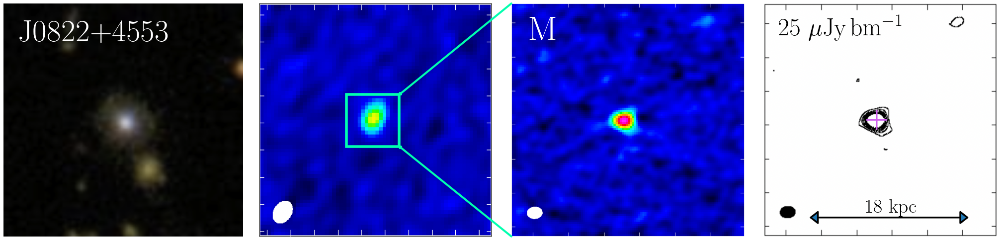

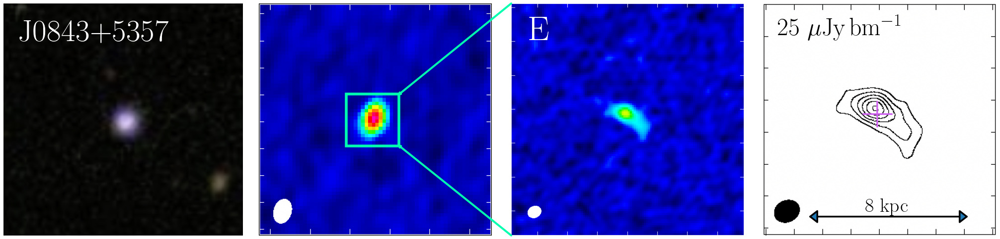

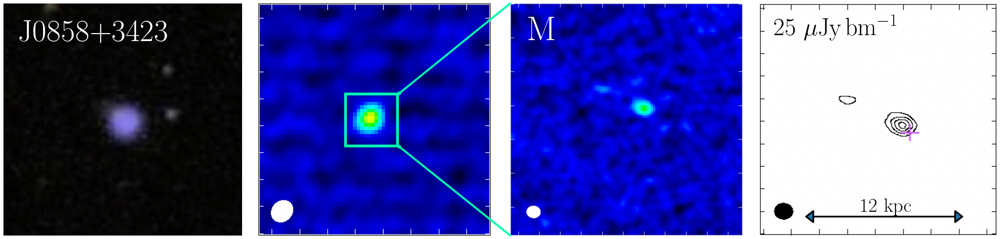

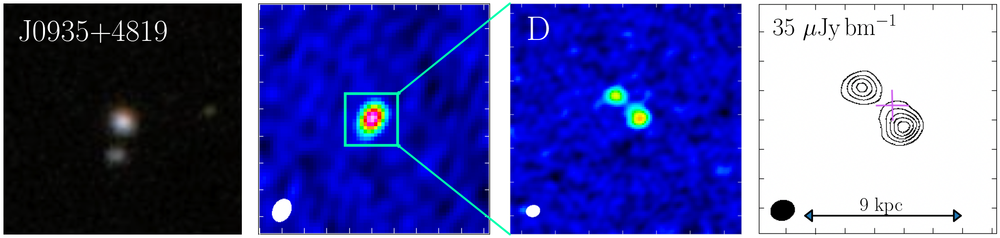

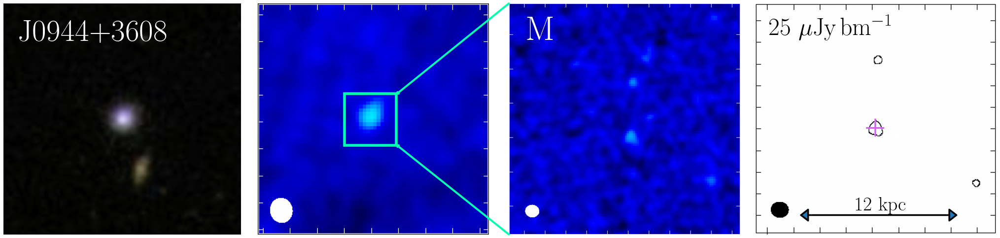

...

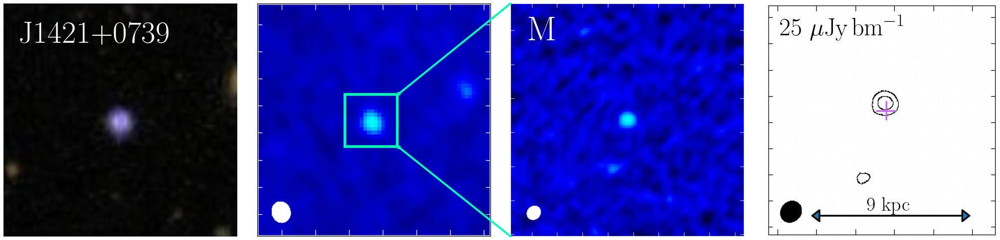

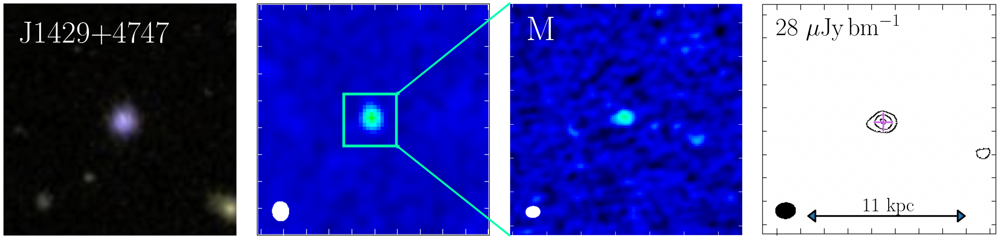

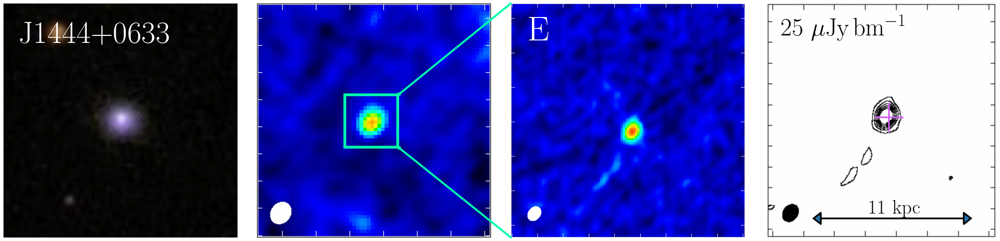

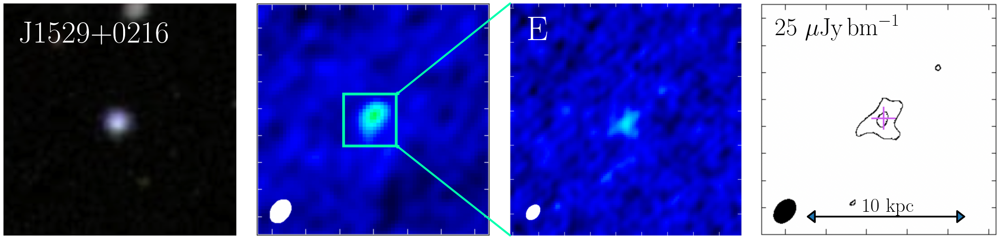

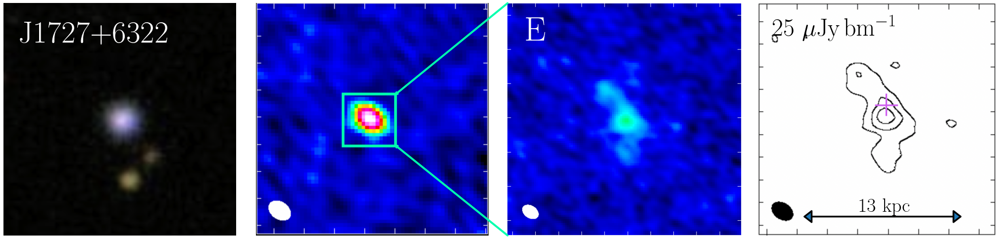

In [42]:
path = "PaperPlots/contour_maps/"

for obj in imgs:
    if not obj.startswith("."): #ignore hidden files/directories
        fig, [ax0, ax1, ax2, ax3] = plt.subplots(1, 4, figsize=(30,7))
        
        #Show the SDSS u?-image
        imSDSS = img.imread(path+obj+"/{}_SDSS.png".format(obj))
        ax0.imshow(imSDSS)
        ax0.annotate("J"+obj, xy=(25, 60), xytext=(0, 0), textcoords='offset points', 
                     color="w", fontsize=62.5)
        
        #Show the C-config image
        imC = img.imread(path+obj+"/{}_colorC.png".format(obj))
        ax1.imshow(imC)
        
        #Define the zoom region (the unresolved source)
        boxcol  = "#00FFAE"
        zoomblcx= 0.375
        zoomblcy= 0.385
        dimbox  = 0.225
        zoombox = Rectangle((zoomblcx, zoomblcy), dimbox, dimbox, facecolor="none", edgecolor=boxcol, linewidth=5.5, 
                            transform=ax1.transAxes)
        ax1.add_patch(zoombox) 
            
        # Draw an arrow between the same point in data coordinates,
        # but on different axes.
        con1 = ConnectionPatch(
            xyA=(0.0,1.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+dimbox-.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con1)

        con2 = ConnectionPatch(
            xyA=(0.0,0.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con2)
                
        imA = img.imread(path+obj+"/{}_A.png".format(obj))
        ax2.imshow(imA)
        ax2.annotate(imgs[obj][morph], xy=(80, 165), fontsize=70, color="w",
                                  xytext=(0, 0), textcoords='offset points')
        
        #Show the Contour map
        imCont = img.imread(path+obj+"/{}_contourmap.png".format(obj))
        ax3.imshow(imCont)
        
        ax3.annotate('', xy=(135, 650), xytext=(325, 0), textcoords='offset points', 
                        arrowprops=dict(arrowstyle="<|-|>, head_width=0.7, head_length=0.9",
                                       linewidth=3.5))
        ax3.annotate(str(round(0.6*imgs[obj][imsize]))+" kpc", xy=(310, 635), xytext=(0, 0), 
                     textcoords='offset points', fontsize=40) 
        
        if obj=="1045+2933":
            ax3.annotate(str(round(imgs[obj][scale]))+" $\mu$Jy\,bm$^{-1}$", xy=(45, 180), fontsize=50,
                                  xytext=(0, 0), textcoords='offset points')
        else:
            ax3.annotate(str(round(imgs[obj][scale]))+" $\mu$Jy\,bm$^{-1}$", xy=(45, 100), fontsize=50,
                                  xytext=(0, 0), textcoords='offset points')
        
    
        #fig.text(0.09, 0.08, "SDSS Image", color="w", fontsize=50)
        #fig.text(0.30, 0.08, "C-config ($\sim3.5''$)", color="w", fontsize=50)
        #fig.text(0.53, 0.08, "A-config ($\sim0.33''$)", color="w", fontsize=50) 
        ax0.axis("off")
        ax1.axis("off")
        ax2.axis("off")
        ax3.axis("off")
        plt.subplots_adjust(left=0.05, right=0.9, bottom=0.2, top=0.8)
        plt.tight_layout()
        #plt.savefig("AASPlots/{}_{}_insets.png".format(imgs[obj][morph], obj), bbox_inches = 'tight', pad_inches = 0)
        plt.savefig("PaperPlots/images_insets/{}_{}_insets.pdf".format(imgs[obj][morph], obj), bbox_inches = 'tight', pad_inches = 0)
        plt.show()

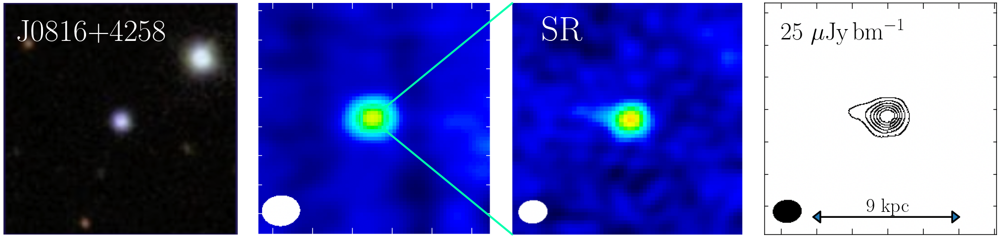

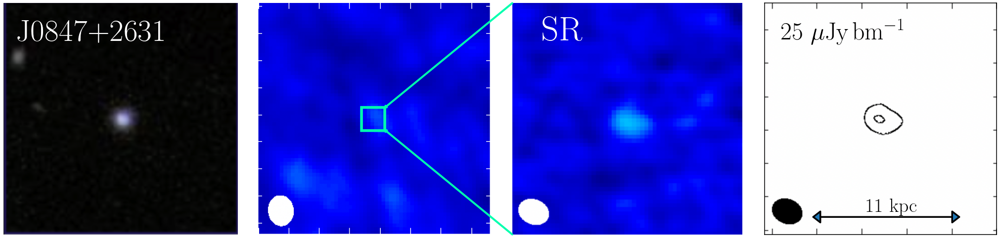

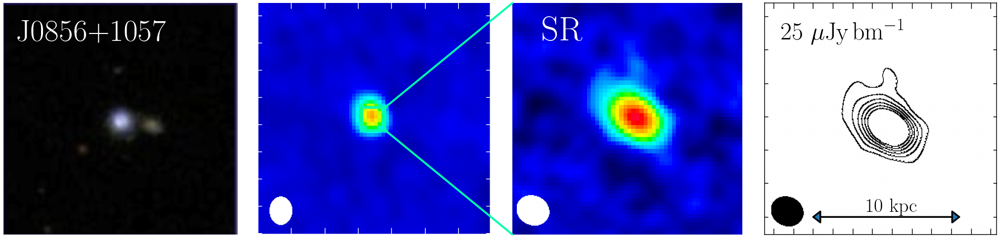

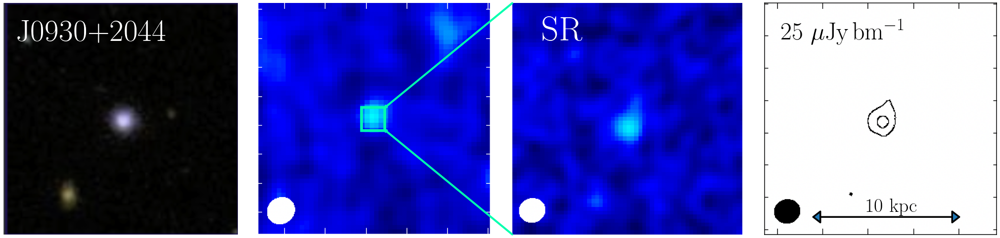

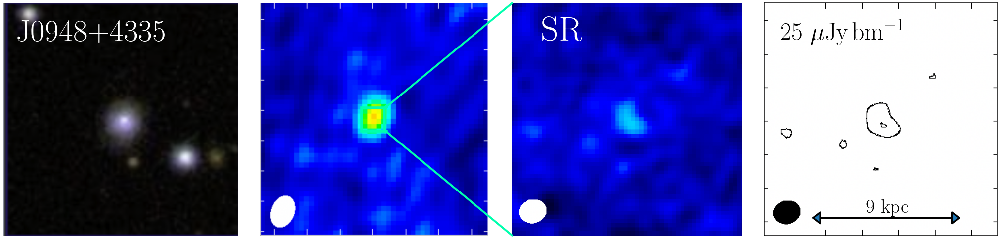

...

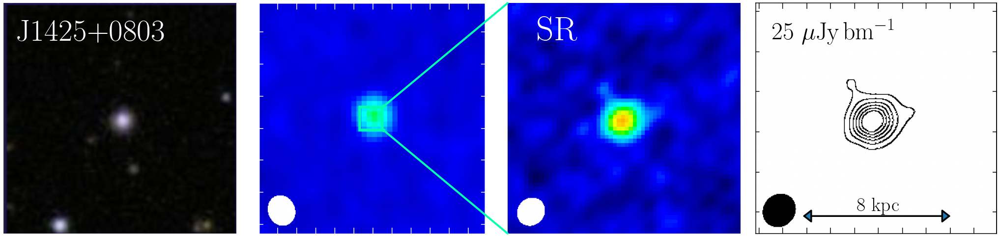

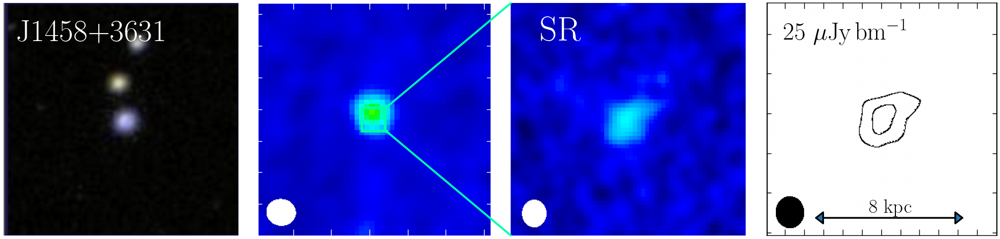

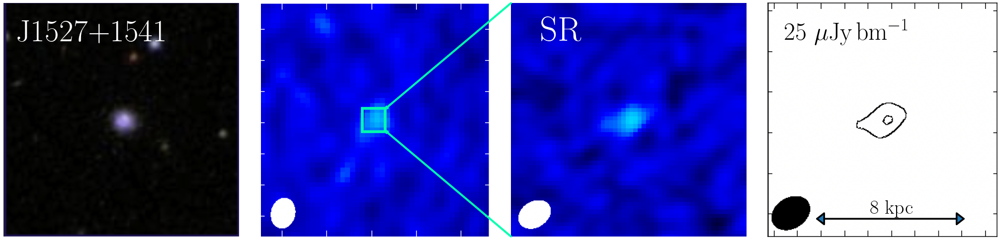

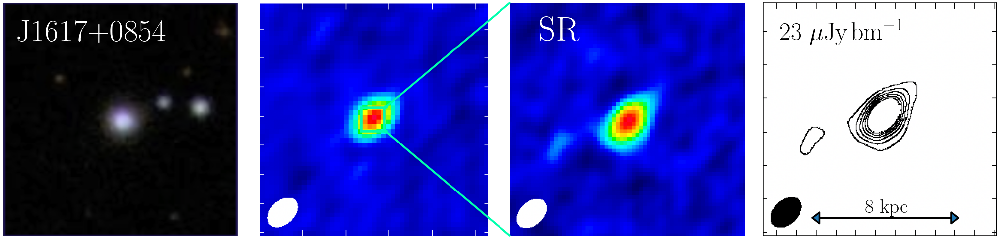

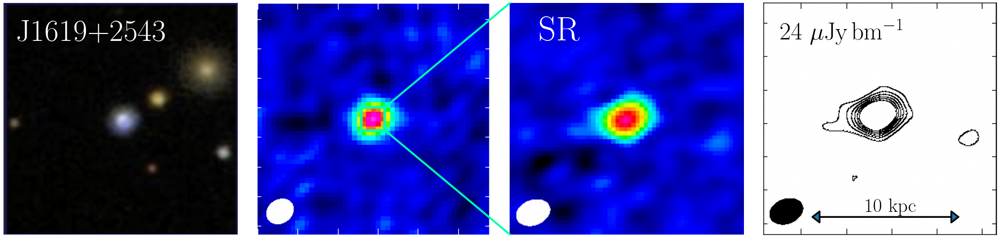

In [35]:
path = "PaperPlots/contour_maps_SR/"

for obj in imgs_SR:
#for obj in ["1458+3631"]:
    if not obj.startswith("."): #ignore hidden files/directories
        fig, [ax0, ax1, ax2, ax3] = plt.subplots(1, 4, figsize=(30,7))
        
        #Show the SDSS u?-image
        imSDSS = img.imread(path+obj+"/{}_SDSS.png".format(obj))
        ax0.imshow(imSDSS)
        ax0.annotate("J"+obj, xy=(25, 70), xytext=(0, 0), textcoords='offset points', 
                     color="w", fontsize=62.5)
        
        #Show the C-config image
        imC = img.imread(path+obj+"/{}_colorC.png".format(obj))
        ax1.imshow(imC)
        
        #Define the zoom region (the unresolved source)
        boxcol  = "#00FFAE"
        #boxcol  = "#fca903"
        zoomblcx= 0.4455
        zoomblcy= 0.45
        dimbox  = 0.100
        zoombox = Rectangle((zoomblcx, zoomblcy), dimbox, dimbox, facecolor="none", edgecolor=boxcol, linewidth=5.5, 
                            transform=ax1.transAxes)
        ax1.add_patch(zoombox) 
            
        # Draw an arrow between the same point in data coordinates,
        # but on different axes.
        con1 = ConnectionPatch(
            xyA=(0.0,1.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+dimbox-.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con1)

        con2 = ConnectionPatch(
            xyA=(0.0,0.0), coordsA=ax2.transAxes,
            xyB=(zoomblcx+dimbox-.015, zoomblcy+.015), coordsB=ax1.transAxes,
            arrowstyle="->", shrinkB=5, color=boxcol, linewidth=4.0)
        fig.add_artist(con2)
                
        imA = img.imread(path+obj+"/{}_A.png".format(obj))
        ax2.imshow(imA)
        ax2.annotate("SR", xy=(80, 100), fontsize=70, color="w",
                                  xytext=(0, 0), textcoords='offset points')
        
        #Show the Contour map
        imCont = img.imread(path+obj+"/{}_contourmap.png".format(obj))
        ax3.imshow(imCont)
        
        ax3.annotate('', xy=(125, 580), xytext=(305, 0), textcoords='offset points', 
                        arrowprops=dict(arrowstyle="<|-|>, head_width=0.7, head_length=0.9",
                                       linewidth=3.5))
        ax3.annotate(str(round(imgs_SR[obj][imsize]))+" kpc", xy=(275, 565), xytext=(0, 0), color="k",
                     textcoords='offset points', fontsize=40) 
        ax3.annotate(str(round(np.sqrt(2)*imgs_SR[obj][scale]))+" $\mu$Jy\,bm$^{-1}$", xy=(45, 100), fontsize=50,
                              xytext=(0, 0), textcoords='offset points')

        ax0.axis("off")
        ax1.axis("off")
        ax2.axis("off")
        #ax3.axis("off")
        ax3.set_xticks([])
        ax3.set_yticks([])
        plt.subplots_adjust(left=0.05, right=0.9, bottom=0.2, top=0.8)
        plt.tight_layout()
        plt.savefig("PaperPlots/images_insets/{}_{}_insets.pdf".format("SR", obj), bbox_inches = 'tight', pad_inches = 0)
        plt.show()

In [36]:
imgs_SR[obj][imsize]

9.9

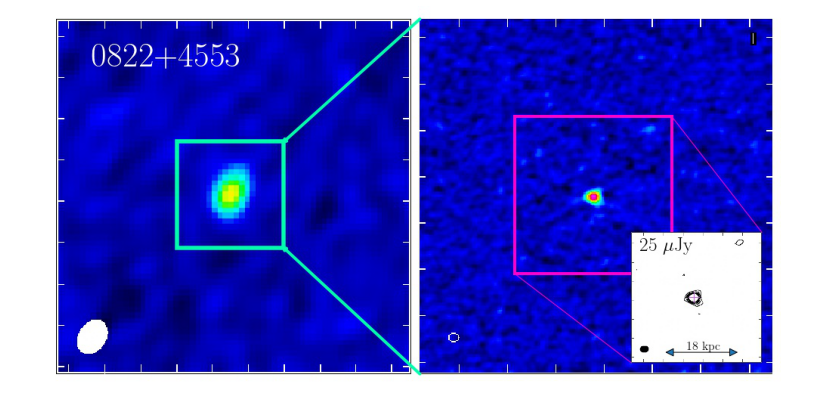

In [37]:
fig = plt.figure(figsize=(15,7))
im = img.imread("PaperPlots/images_insets/0822+4553_insets.jpg")
plt.imshow(im)
plt.axis("off")
plt.show()

NameError: name 'pathdir' is not defined

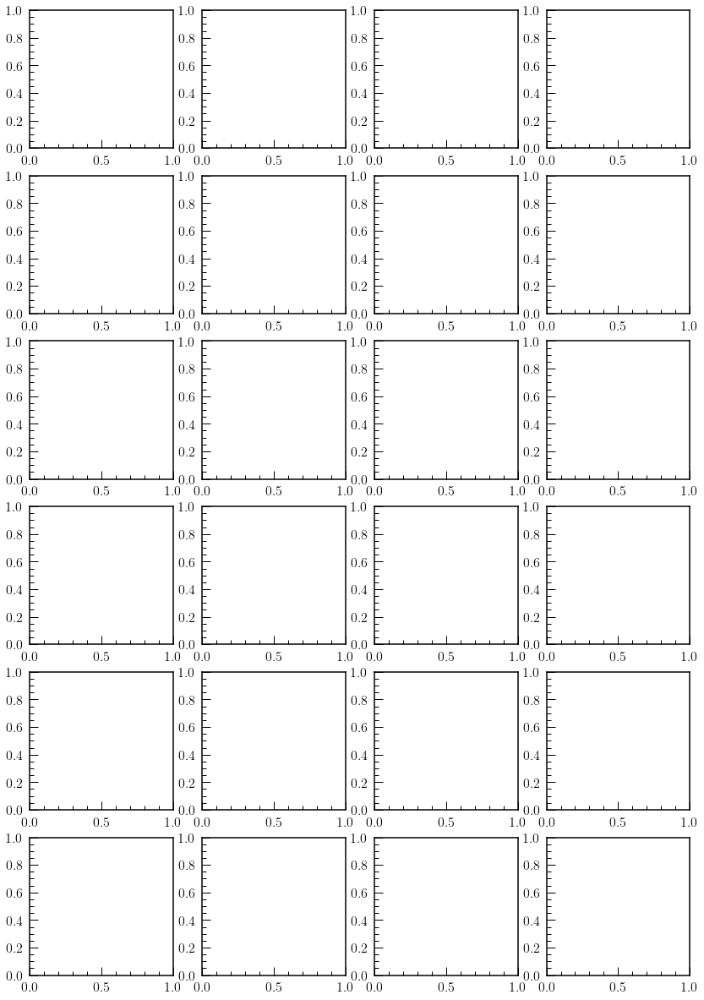

In [38]:
fig, axs = plt.subplots(6, 4, figsize=(14,21))

r = 0
c = 0


for obj in pathdir:
    if not obj.startswith("."): #ignore hidden files/directories
        for i in os.listdir(path+obj+"/"):    
            if not i.startswith("."):
   
                im = img.imread(path+obj+"/"+i)
                axs[r,c].imshow(im)

                title = i.split('_')
                axs[r,c].set_title(title[0])
                axs[r,c].axes.xaxis.set_ticklabels([])
                axs[r,c].axes.yaxis.set_ticklabels([])
                axs[r,c].xaxis.set_ticks_position('none')
                axs[r,c].yaxis.set_ticks_position('none')
                
                axs[r,c].annotate('', xy=(105, 650), xytext=(158, 0), textcoords='offset points', 
                        arrowprops=dict(arrowstyle="<|-|>, head_width=0.3, head_length=0.6"))
                axs[r,c].annotate(str(round(0.6*imgs[title[0]][imsize]))+" kpc", xy=(300, 635), xytext=(0, 0), textcoords='offset points') 
                axs[r,c].annotate(str(round(imgs[title[0]][scale]))+" $\mu$Jy", xy=(45, 100), fontsize=27.5,
                                  xytext=(0, 0), textcoords='offset points') 
                #axs[r,c].axis("off")

                c += 1
                c = c%4
                if c==0: r+=1


plt.subplots_adjust(wspace=0.0, hspace=0.145)
plt.tight_layout()
plt.savefig("PaperPlots/complexsources_contourmosaic.pdf")

In [ ]:
ax2.get_xlim()